# Plot ceilometer data for BELUGA STN campaign

#### Packages

In [1]:
import os
import glob

import numpy as np
import pandas as pd
import xarray as xr

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import dates

import metpy.calc as mpcalc
from metpy.units import units

C:\Users\u300737\AppData\Local\anaconda3\lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [2]:
# merged BELUGA L2-data as df
def get_merged_beluga_L2(flight_date, var="Theta"):
    if var=="Theta":
        l2_data_path=os.getcwd()+"/../BELUGA_data//BELUGA_TMP_met_probe//temporary_data//"
        fnames="BELUGA_STN_L2_TMP_met_RF*"+flight_date+"*v2.2*"
        files=glob.glob(l2_data_path+fnames)
        BELUGA_l2_ds=xr.open_mfdataset(files)
        beluga_df=BELUGA_l2_ds[["z_b","p","T","rh"]].to_dataframe()
        print(beluga_df["T"].std())
        #beluga_df["T"][abs(beluga_df["T"]-beluga_df["T"].mean())>0.5*beluga_df["T"].std()]=np.nan
        beluga_df["Theta"]=np.nan
        # Prepare for metpy
        T_profile=beluga_df["T"]
        T_profile=T_profile * units.kelvin
        p_hPa=beluga_df["p"]
        p_hPa=p_hPa * units.hPa
        Theta_profile=mpcalc.potential_temperature(
            p_hPa.values * units.hPa,T_profile.values * units.kelvin)
        beluga_df["Theta"]=np.array(Theta_profile)
        #beluga_df["Theta"][beluga_df["Theta"]>262]=np.nan
    elif var=="F_down":
        l2_data_path=os.getcwd()+"/../BELUGA_data//BELUGA_broadband_probe//temporary_data//"
        fnames="BELUGA_STN_L2_BP*"+flight_date+"*v2.2*"
        files=glob.glob(l2_data_path+fnames)
        BELUGA_l2_ds=xr.open_mfdataset(files)
        beluga_df=BELUGA_l2_ds[["z_b","F_down","F_up","F_net"]].to_dataframe()
    else:
        raise Exception("wrong variable")
    return beluga_df

# ceilometer data
def plot_ceilometer_backscatter(ceilo_ds,flight,flight_date,
                                with_cbh=False,with_BELUGA=False,BELUGA_var="Theta"):
    
    fmtr = dates.DateFormatter("%H:%M")
    ceilo_fig=plt.figure(figsize=(16,9))
    matplotlib.rcParams.update({"font.size":18})
    ax1=ceilo_fig.add_subplot(111)
    x,y=np.meshgrid(ceilo_ds.time,ceilo_ds["level_height"][:,0]/1000)
    C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
                      vmin=-3.5,vmax=-1,cmap="cubehelix_r")
    cbar1=plt.colorbar(C1, orientation='vertical',
                 label="Attenuated volume \nbackscattering coefficient ($10^{x}$ sr-1 km-1 )")
    if with_cbh:
        ax1.plot(pd.DatetimeIndex(ceilo_ds.time), ceilo_ds["cbh_1"].values[:]/1000,lw=2,color="red",label="lowest CBH",zorder=1)     
        ax1.plot(ceilo_ds.time, ceilo_ds["layer_height"][:,0].values[:]/1000,
             color="k",label="lowest ABL",zorder=1)
    if with_BELUGA:
        if BELUGA_var=="Theta":
            try:
                beluga_df=get_merged_beluga_L2(flight_date,var=BELUGA_var)
                ax1.plot(beluga_df.index,beluga_df["z_b"]/1000,color="whitesmoke",lw=7,zorder=2)
                C2=ax1.scatter(beluga_df.index,beluga_df["z_b"]/1000,c=beluga_df["Theta"],s=10,
                               vmin=240,vmax=270,cmap="Spectral_r",zorder=3,label="BELUGA")
                cax2 = ceilo_fig.add_axes([.5, 0.95, 0.2, 0.05])
                cbar=plt.colorbar(C2, cax=cax2,orientation="horizontal")
                cbar.set_label("BELUGA $\Theta$ (K)", labelpad=-1)
                cbar.set_ticks([240,250,260,270])
                
                ax1.set_ylim([0,7.5])
                ax1.set_ylabel("Height (km)")
                ax1.set_xlabel(flight_date+" Time (UTC)")
                ax1.xaxis.set_major_formatter(fmtr)
                [ax1.spines[axis].set_linewidth(2) for axis in ['bottom','left']]
                ax1.spines[['right', 'top']].set_visible(False)
                ax1.yaxis.set_tick_params(width=2,length=8)
                ax1.xaxis.set_tick_params(width=2,length=8)
                fig_name="STN_ceilometer_backscatter_"+flight_date
                if with_cbh:
                    ax1.legend()
                    fig_name+="_with_CBH"
                if with_BELUGA:
                    fig_name+="_with_BELUGA_"+BELUGA_var
                fig_name+=".png"
                plot_path=os.getcwd()+"/../plots/"+flight+"/"
                os.makedirs(plot_path,exist_ok=True)
                ceilo_fig.savefig(plot_path+fig_name, bbox_inches="tight",dpi=300)
                print("Figure saved as:"+plot_path+fig_name)
            except:
                pass
        elif BELUGA_var=="F_down":
            try:
                beluga_df=get_merged_beluga_L2(flight_date,var=BELUGA_var)
                ax1.plot(beluga_df.index,beluga_df["z_b"]/1000,color="whitesmoke",lw=7,zorder=2)
                C2=ax1.scatter(beluga_df.index,beluga_df["z_b"]/1000,c=beluga_df["F_down"],s=10,
                               vmin=120,vmax=240,cmap="nipy_spectral",zorder=3,label="BELUGA")
                cax2 = ceilo_fig.add_axes([.5, 0.95, 0.2, 0.05])
                cbar=plt.colorbar(C2, cax=cax2,orientation="horizontal")
                cbar.set_label("BELUGA $F_{↓}$ (W m$^{-2}$)", labelpad=-1)
                cbar.set_ticks([120,160,200,240])
                
                ax1.set_ylim([0,7.5])
                ax1.set_ylabel("Height (km)")
                ax1.set_xlabel(flight_date+" Time (UTC)")
                ax1.xaxis.set_major_formatter(fmtr)
                [ax1.spines[axis].set_linewidth(2) for axis in ['bottom','left']]
                ax1.spines[['right', 'top']].set_visible(False)
                ax1.yaxis.set_tick_params(width=2,length=8)
                ax1.xaxis.set_tick_params(width=2,length=8)
                fig_name="STN_ceilometer_backscatter_"+flight_date
                if with_cbh:
                    ax1.legend()
                    fig_name+="_with_CBH"
                if with_BELUGA:
                    fig_name+="_with_BELUGA_"+BELUGA_var
                fig_name+=".png"
                plot_path=os.getcwd()+"/../plots/"+flight+"/"
                os.makedirs(plot_path,exist_ok=True)
                ceilo_fig.savefig(plot_path+fig_name, bbox_inches="tight",dpi=300)
                print("Figure saved as:"+plot_path+fig_name)
            except:
                pass
    return None

In [3]:
main_data_path="C://Users//u300737//Desktop//Desktop_alter_Rechner//"+\
    "BELUGA_Leipzig_AC3"+"//Code//GIT//STN_analysis//BELUGA_data//"
ceilometer_data_path=main_data_path+"ceilometer//"


rfs_dict= {"RF01":"20240324","RF02":"20240324",
    "RF03":"20240325","RF04":"20240325","RF05":"20240326",
    "RF06":"20240326","RF07":"20240327","RF08":"20240328",
    "RF09":"20240328","RF10":"20240329","RF11":"20240330",
    "RF12":"20240401","RF13":"20240401","RF14":"20240401",
    "RF15":"20240402","RF16":"20240402","RF17":"20240403",
    "RF18":"20240404","RF19":"20240404","RF20":"20240405",
    "RF21":"20240406","RF22":"20240407","RF23":"20240408",
    "RF24":"20240408","RF25":"20240409","RF26":"20240410",
    "RF27":"20240411","RF28":"20240412",
}    

In [4]:
# RF to analyse
flight="RF15"
flight_date=rfs_dict[flight]

ceilo_fname="A4"+flight_date[4:8]+"*.nc"
ceilo_files=glob.glob(ceilometer_data_path+ceilo_fname)

In [5]:
# Test and get variable information
ceilo_ds=xr.open_mfdataset(ceilo_files,concat_dim="time",combine="nested")#xr.open_dataset(ceilo_files[0]) 
ceilo_ds["level_height"]=ceilo_ds["level"]*ceilo_ds["vertical_resolution"]
ceilo_ds

<xarray.Dataset>
Dimensions:               (time: 4888, level: 770, layer: 5)
Coordinates:
  * time                  (time) datetime64[ns] 2024-04-02T02:16:38 ... 2024-...
  * level                 (level) int32 0 1 2 3 4 5 ... 764 765 766 767 768 769
  * layer                 (layer) int32 0 1 2 3 4
Data variables: (12/33)
    id                    (time) object dask.array<chunksize=(838,), meta=np.ndarray>
    time_utc              (time) object dask.array<chunksize=(838,), meta=np.ndarray>
    backscatter           (time, level) float32 dask.array<chunksize=(838, 770), meta=np.ndarray>
    unit                  (time) |S1 dask.array<chunksize=(838,), meta=np.ndarray>
    software_level        (time) float64 dask.array<chunksize=(838,), meta=np.ndarray>
    message_number        (time) float64 dask.array<chunksize=(838,), meta=np.ndarray>
    ...                    ...
    receiver_gain         (time) |S1 dask.array<chunksize=(838,), meta=np.ndarray>
    receiver_bandwidth    (time) |S1 dask.array<chunksize=(838,), meta=np.ndarray>
    backscatter_sum       (time) float32 dask.array<chunksize=(838,), meta=np.ndarray>
    layer_height          (time, layer) float64 dask.array<chunksize=(838, 5), meta=np.ndarray>
    layer_cloud_amount    (time, layer) float64 dask.array<chunksize=(838, 5), meta=np.ndarray>
    level_height          (level, time) float64 dask.array<chunksize=(770, 838), meta=np.ndarray>
Attributes:
    software:  cl2nc (https://github.com/peterkuma/cl2nc)
    version:   3.6.0
    created:   2024-12-04T15:40:25Z

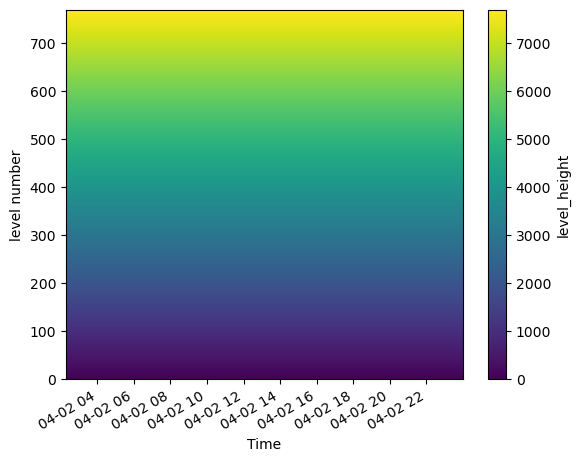

In [6]:
ceilo_ds["level_height"].plot()

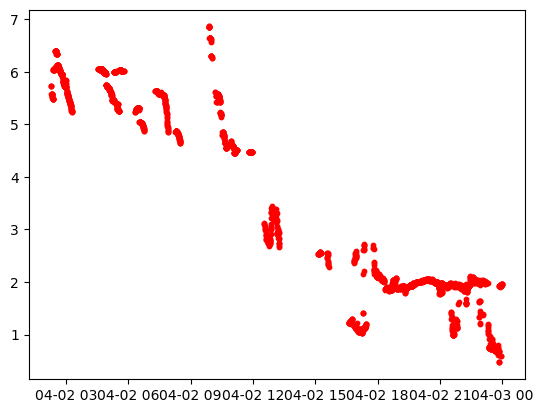

In [7]:
plt.scatter(pd.DatetimeIndex(ceilo_ds.time), ceilo_ds["cbh_1"].values[:]/1000,marker="o",s=10,
                 color="red",label="lowest CBH",zorder=1)     

### Ceilometer data backscatter plot

In [8]:
#plot_ceilometer_backscatter(ceilo_ds,with_BELUGA=False)

#### With BELUGA

C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


2.5063414803972517
Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF15/STN_ceilometer_backscatter_20240402_with_BELUGA_Theta.png


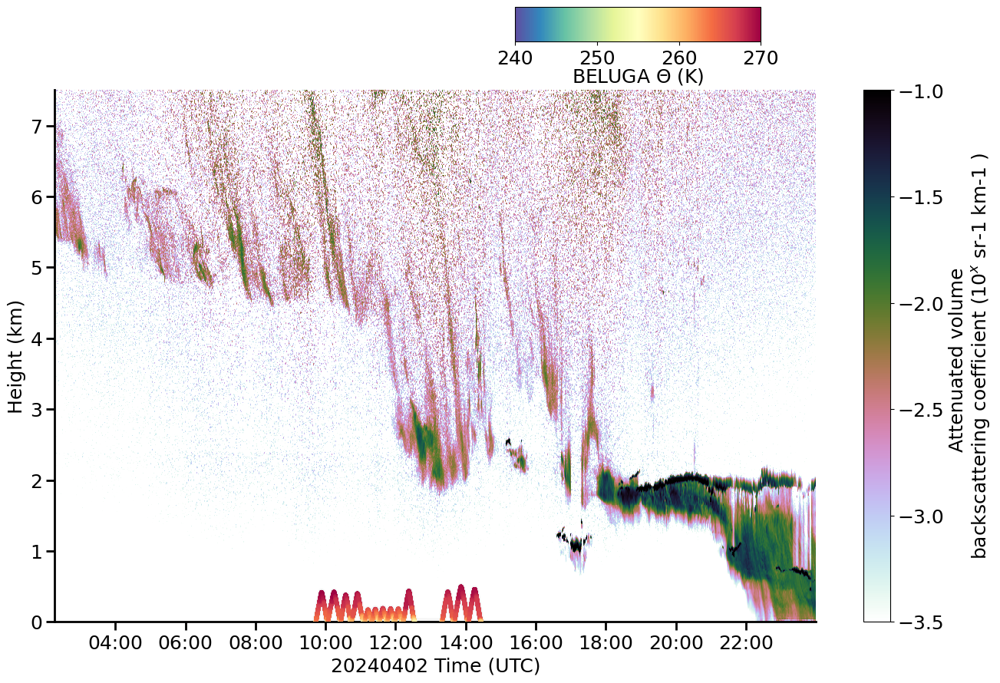

In [9]:
plot_ceilometer_backscatter(ceilo_ds,flight, flight_date, with_BELUGA=True,BELUGA_var="Theta")

opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240325.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF03/STN_ceilometer_backscatter_20240325_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240325.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF04/STN_ceilometer_backscatter_20240325_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240326.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF05/STN_ceilometer_backscatter_20240326_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240326.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF06/STN_ceilometer_backscatter_20240326_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240327.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF07/STN_ceilometer_backscatter_20240327_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240328.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF08/STN_ceilometer_backscatter_20240328_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240328.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF09/STN_ceilometer_backscatter_20240328_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240329.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF10/STN_ceilometer_backscatter_20240329_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240330.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF11/STN_ceilometer_backscatter_20240330_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240401.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF12/STN_ceilometer_backscatter_20240401_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240401.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF13/STN_ceilometer_backscatter_20240401_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240401.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF14/STN_ceilometer_backscatter_20240401_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240402.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF15/STN_ceilometer_backscatter_20240402_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240402.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF16/STN_ceilometer_backscatter_20240402_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240403.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF17/STN_ceilometer_backscatter_20240403_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240404.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF18/STN_ceilometer_backscatter_20240404_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240404.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF19/STN_ceilometer_backscatter_20240404_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240405.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240406.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF21/STN_ceilometer_backscatter_20240406_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240407.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF22/STN_ceilometer_backscatter_20240407_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240408.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  ceilo_fig=plt.figure(figsize=(16,9))
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF23/STN_ceilometer_backscatter_20240408_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240408.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF24/STN_ceilometer_backscatter_20240408_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240409.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF25/STN_ceilometer_backscatter_20240409_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240410.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF26/STN_ceilometer_backscatter_20240410_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240411.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF27/STN_ceilometer_backscatter_20240411_with_BELUGA_F_down.png
opened ceilo file C://Users//u300737//Desktop//Desktop_alter_Rechner//BELUGA_Leipzig_AC3//Code//GIT//STN_analysis//BELUGA_data//ceilometer//Ceilometer_STN_20240412.nc


C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: divide by zero encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),
C:\Users\u300737\AppData\Local\Temp\ipykernel_51548\2179948470.py:40: RuntimeWarning: invalid value encountered in log10
  C1=ax1.pcolormesh(x,y,np.log10(ceilo_ds["backscatter"].T.values),


Figure saved as:C:\Users\u300737\Desktop\Desktop_alter_Rechner\BELUGA_Leipzig_AC3\Code\GIT\STN_analysis\plotting/../plots/RF28/STN_ceilometer_backscatter_20240412_with_BELUGA_F_down.png


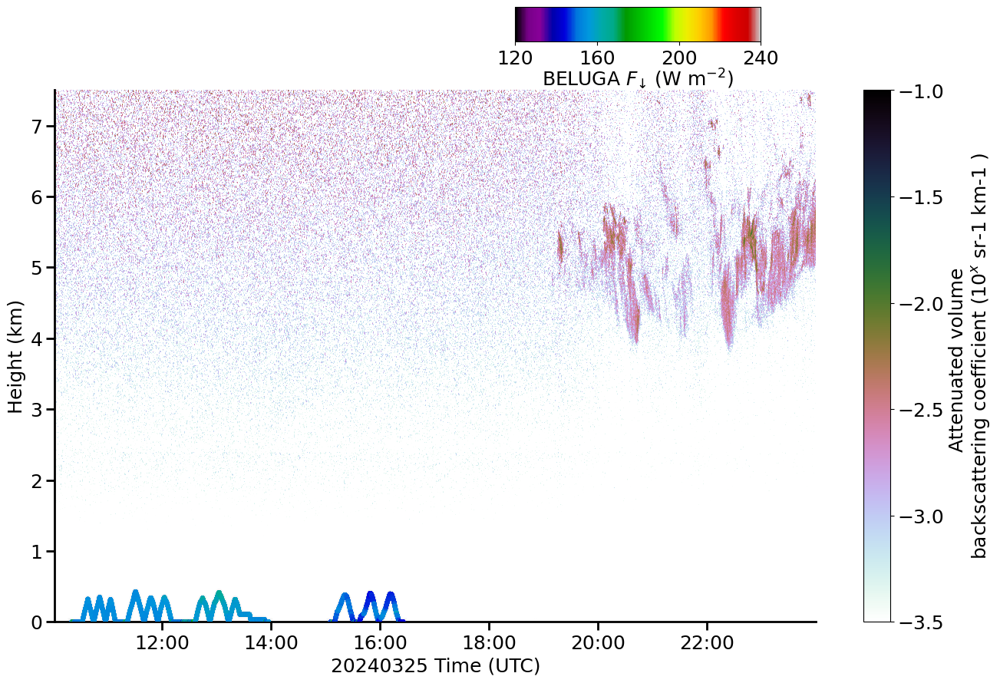

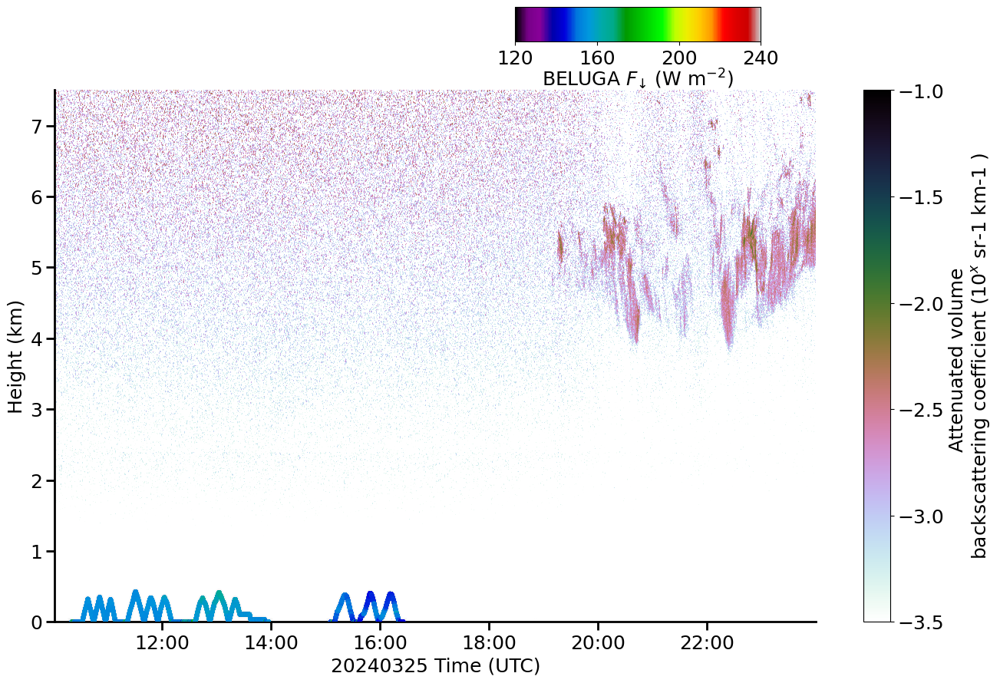

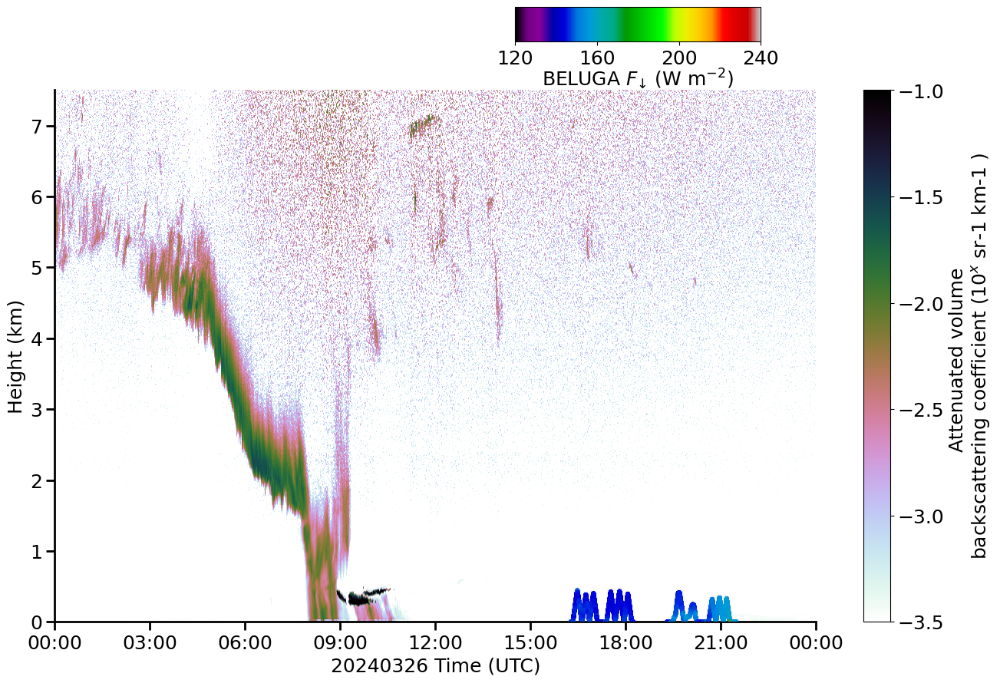

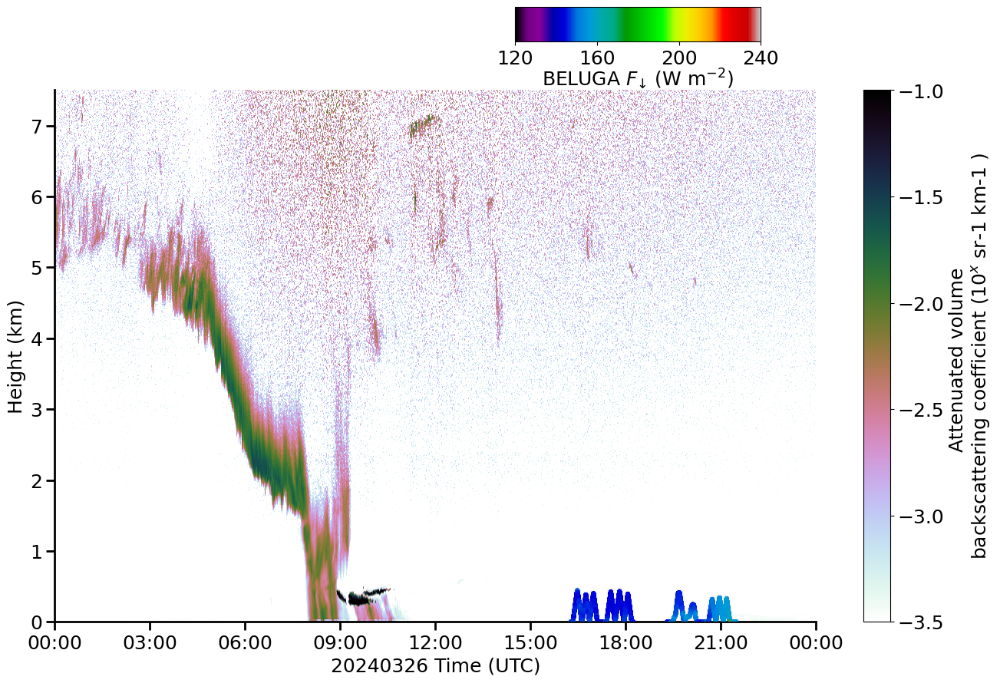

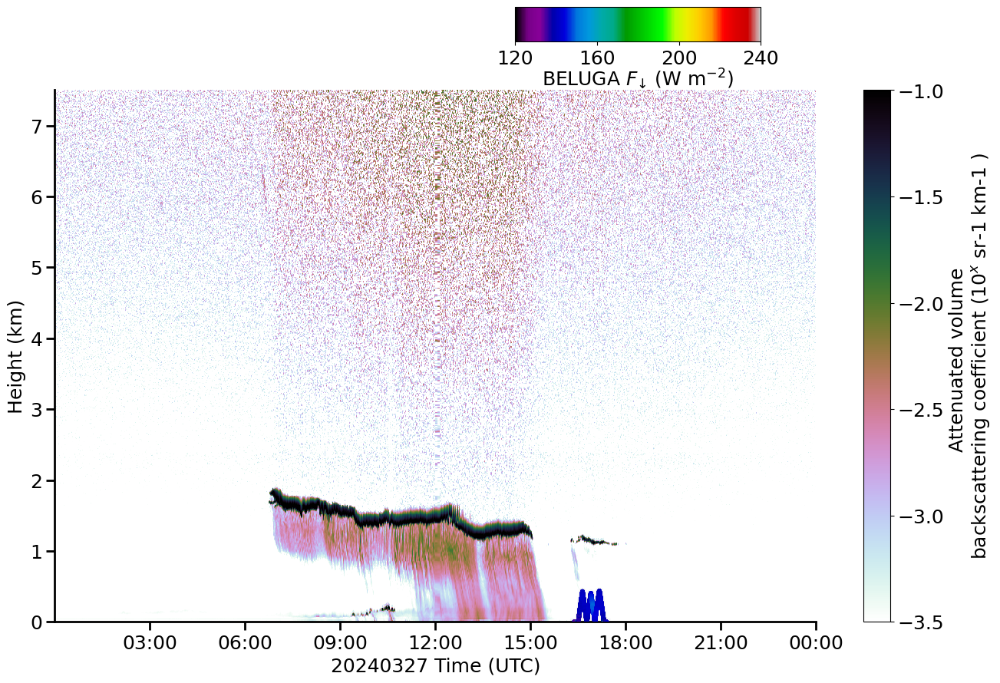

...

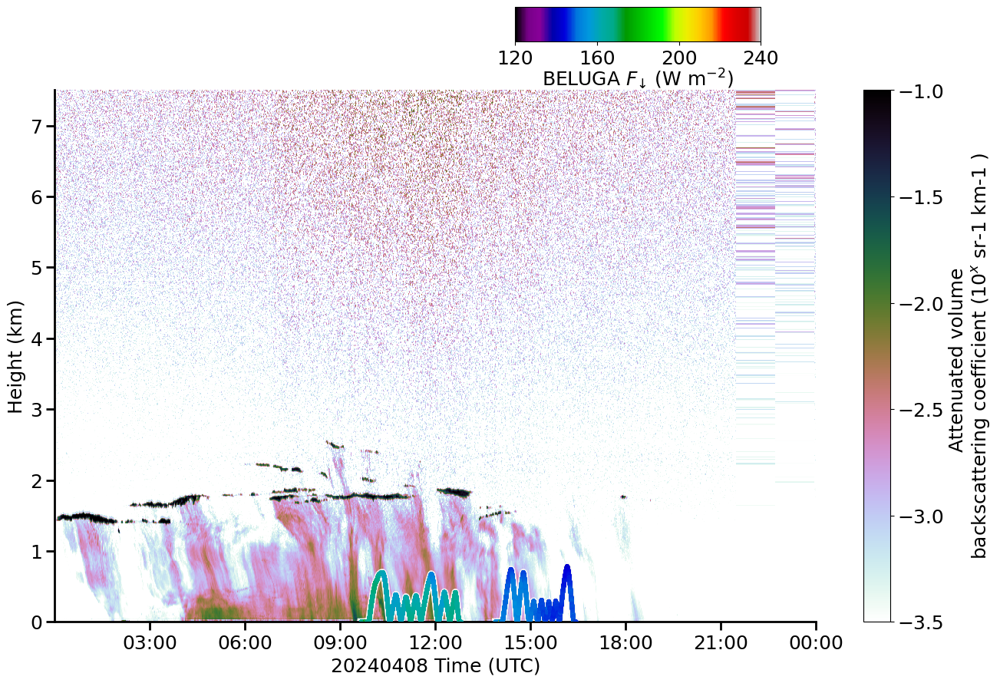

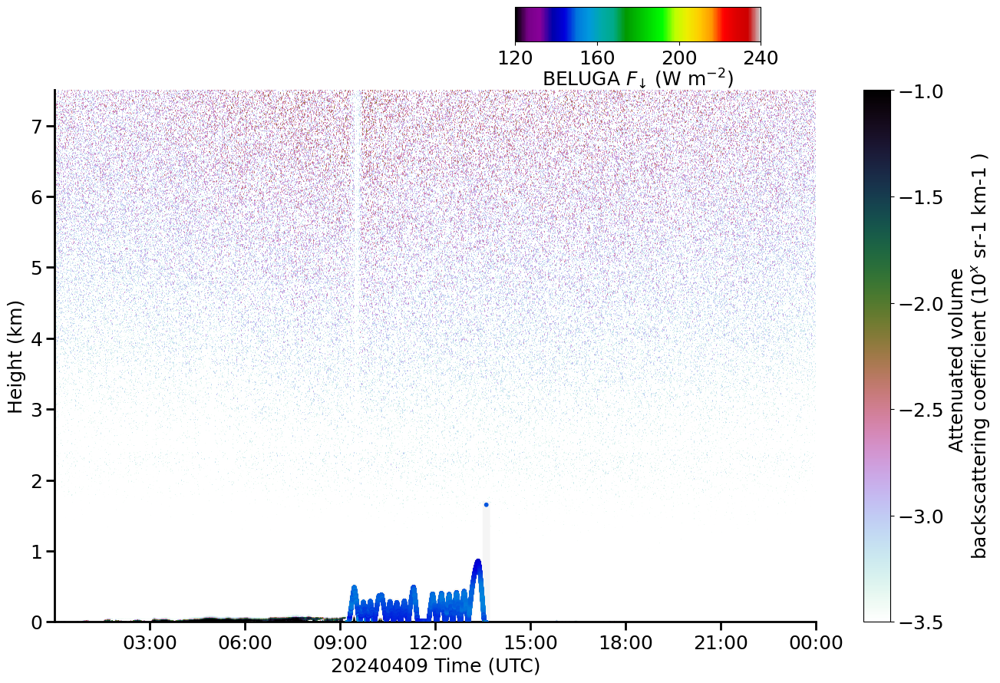

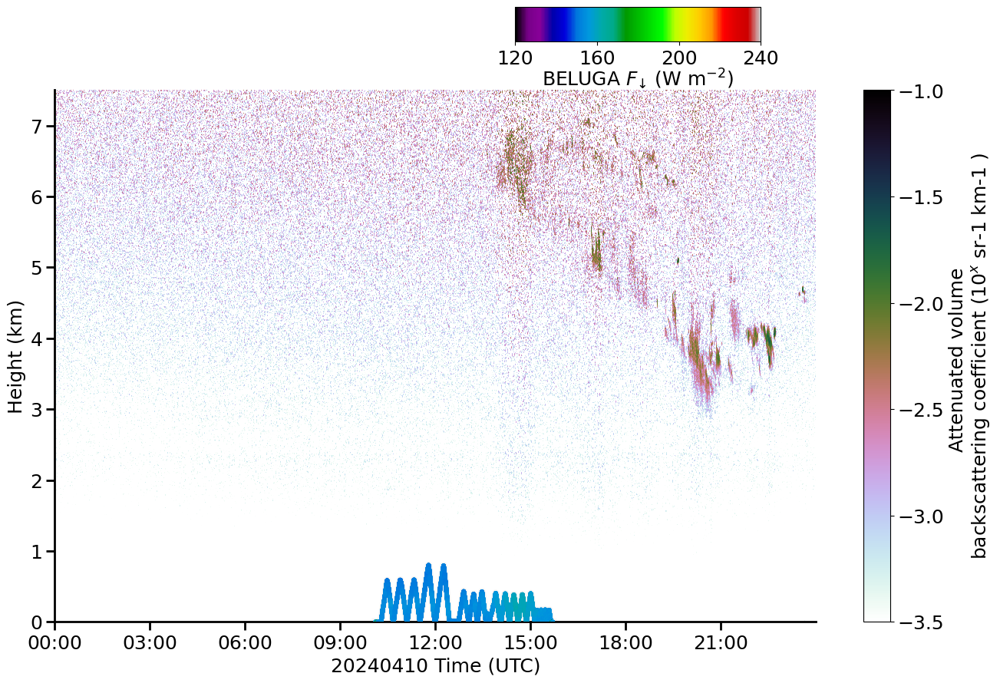

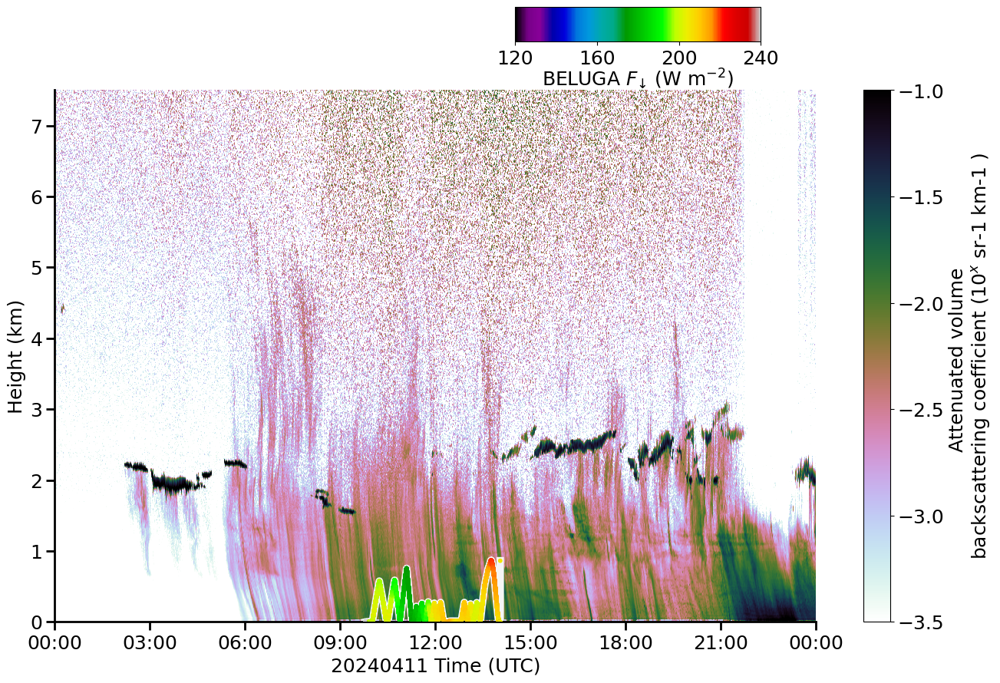

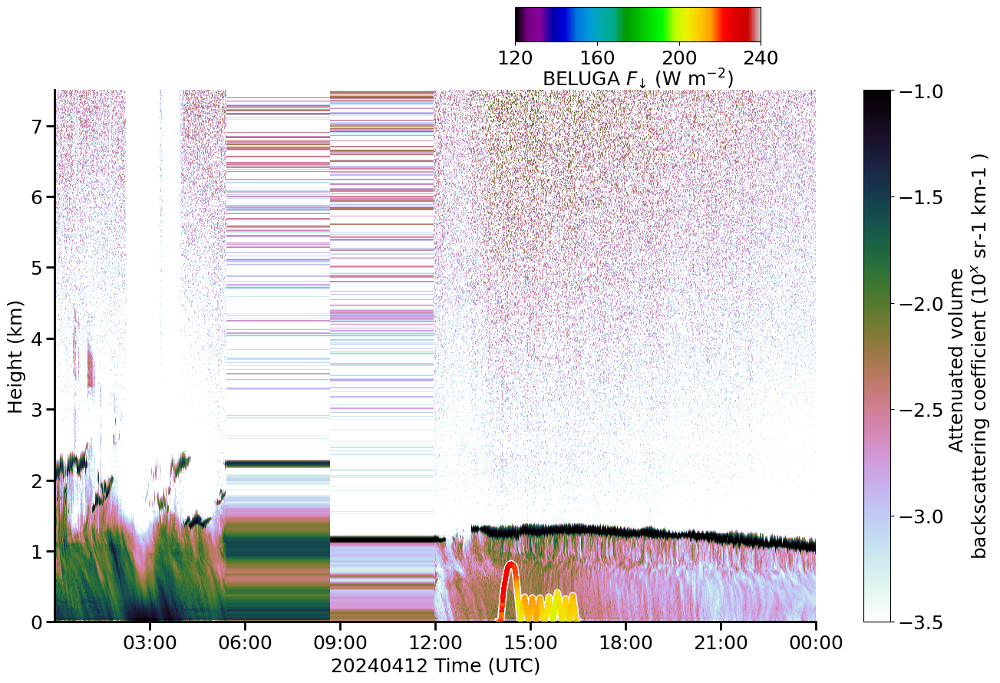

In [10]:
for rf in [*rfs_dict.keys()]:
    flight_date=rfs_dict[rf]
    # check if 
    ceilo_file=ceilometer_data_path+"Ceilometer_STN_"+flight_date+".nc"
    if os.path.exists(ceilo_file):
        ceilo_ds=xr.open_dataset(ceilo_file)
        print("opened ceilo file",ceilo_file)
    else:
        ceilo_fname="A4"+flight_date[4:8]+"*.nc"
        ceilo_files=glob.glob(ceilometer_data_path+ceilo_fname)
        if len(ceilo_files)>0:
            ceilo_ds=xr.open_mfdataset(ceilo_files,concat_dim="time",combine="nested") 
            ceilo_ds["level_height"]=ceilo_ds["level"]*ceilo_ds["vertical_resolution"]
            ceilo_ds.to_netcdf(path=ceilo_file)
            print("File saved as:",ceilo_file)
        else:
            continue
    # Plotting 
    #plot_ceilometer_backscatter(ceilo_ds,rf,flight_date,
    #                            with_BELUGA=True,BELUGA_var="Theta")
    plot_ceilometer_backscatter(ceilo_ds,rf,flight_date,
                               with_BELUGA=True,BELUGA_var="F_down")